In [ ]:
license = ""
secret = ""
aws_access_key = ""
aws_secret_key = ""

version = secret.split("-")[0]
spark_ocr_jar_path = "../../../target/scala-2.12"

In [2]:
from sparkocr import start
import os
import sys

if license:
    os.environ['JSL_OCR_LICENSE'] = license
    os.environ['SPARK_NLP_LICENSE'] = license

if aws_access_key:
    os.environ['AWS_ACCESS_KEY'] = aws_access_key
    os.environ['AWS_SECRET_ACCESS_KEY'] = aws_secret_key

nlp_secret = ""

extra_configurations = {
    "spark.driver.memory" : "50G",
}

spark = start(jar_path=spark_ocr_jar_path, nlp_internal="6.1.0",
              nlp_version="6.1.1", nlp_secret=nlp_secret, extra_conf=extra_configurations)

spark

Spark version: 3.5.0
Spark NLP version: 6.1.1
Spark NLP for Healthcare version: 6.1.0
Spark OCR version: 6.1.0



In [3]:
# 📦 Spark OCR Imports
from sparkocr.transformers import *
from sparkocr.enums import *
from sparkocr.utils import *

# ⚡ Spark NLP Core
from sparknlp.base import *
from sparknlp.annotator import *
from sparknlp.pretrained import PretrainedPipeline

# 🔗 Spark ML
from pyspark.ml import Pipeline, PipelineModel
import pyspark.sql.functions as F

# 🧩 Spark NLP for Healthcare (JSL)
import sparknlp_jsl
from sparknlp_jsl.annotator import *

from IPython.display import display, Markdown

# 📄 Medium-Complexity PDF Files  

When moving to **denser documents**, the challenges increase due to layout variety and added noise.  

---

## 🔹 Characteristics of Medium PDF Files  
- **Different Layouts**  
  - Multi-column sections  
  - Tables with merged cells  
  - Headers & footers with overlapping elements  

- **Added Noise**  
  - Ink bleed through pages  
  - Dirty screen effects  
  - Subtle background textures (e.g., scanned reports, faint grids, hospital letterheads)  

---

# 📄 Hard-Complexity PDF Files  

Hard PDF files represent the **most challenging scenarios** due to their layout density and physical noise artifacts.  

---

## 🔹 Characteristics of Hard PDF Files  
- **Dense Layouts**  
  - Extremely **compact text on single lines** (minimal spacing).  
  - Multi-section pages with overlapping content.  
  - High word density leading to OCR segmentation errors.  

- **Severe Noise Factors**  
  - **Punch holes (left margin)** interfering with line detection.  
  - **Binder clips (right margin)** creating false dark regions.  
  - **Noise texturisation** across the page.  
  - **Moire patterns** (scanner/photocopy artifacts) distorting readability.  

---

In [4]:
easy_input_df = spark.read.format("binaryFile").load("./source_pdfs/Easy/PDF_Deid_Deidentification_0.pdf")

medium_input_df = spark.read.format("binaryFile").load("./source_pdfs/Medium/PDF_Deid_Deidentification_Medium_0.pdf")

hard_input_df = spark.read.format("binaryFile").load("./source_pdfs/Hard/PDF_Deid_Deidentification_Hard_0.pdf")

signature_input_df = spark.read.format("binaryFile").load("./source_pdfs/Other/PDF_Deid_Deidentification_0_Signature.pdf")

### 📄 PDF De-identification (Multilingual Name Plus) 😃

🔗 [Pipeline Link](https://nlp.johnsnowlabs.com/2025/05/17/pdf_deid_multilingual_name_plus.html)

This pipeline can be used to **mask PHI information in PDFs**.  
The output is a **PDF document** similar to the input, but with **black bounding boxes** 🟥 placed over the targeted entities.

---

**🧾 Predicted Entities**
- 🏥 HOSPITAL  
- 👤 NAME  
- 🧑‍⚕️ PATIENT  
- 🆔 ID  
- 📑 MEDICALRECORD  
- 🔢 IDNUM  
- 🌍 COUNTRY  
- 📍 LOCATION  
- 🛣️ STREET  
- 🏞️ STATE  
- 🔢 ZIP  
- 📞 CONTACT  
- ☎️ PHONE  
- 📅 DATE  

---

### 🔄 Pipeline Variants  
- ✨ **Obfuscation Variant** → [Link](https://nlp.johnsnowlabs.com/2025/05/17/pdf_obfuscate_multilingual_name_plus.html)  
   *(Replaces PHI text with synthetic placeholders instead of masking.)*  

- ✍️ **Signature-Aware Variant** → [Link](https://nlp.johnsnowlabs.com/2025/05/17/pdf_deid_multilingual_name_plus_signature_aware.html)  
   *(Ensures de-identification while handling document signatures.)*  

pdf_deid_multilingual_name_plus_signature_aware download started this may take some time.
Approx size to download 4 GB
[OK!]

    Image #0:
    Origin: file:/content/source_pdfs/Other/PDF_Deid_Deidentification_0_Signature.pdf
    Resolution: 300 dpi
    Width: 2400 px
    Height: 3299 px
    Mode: 10
    Number of channels: 1


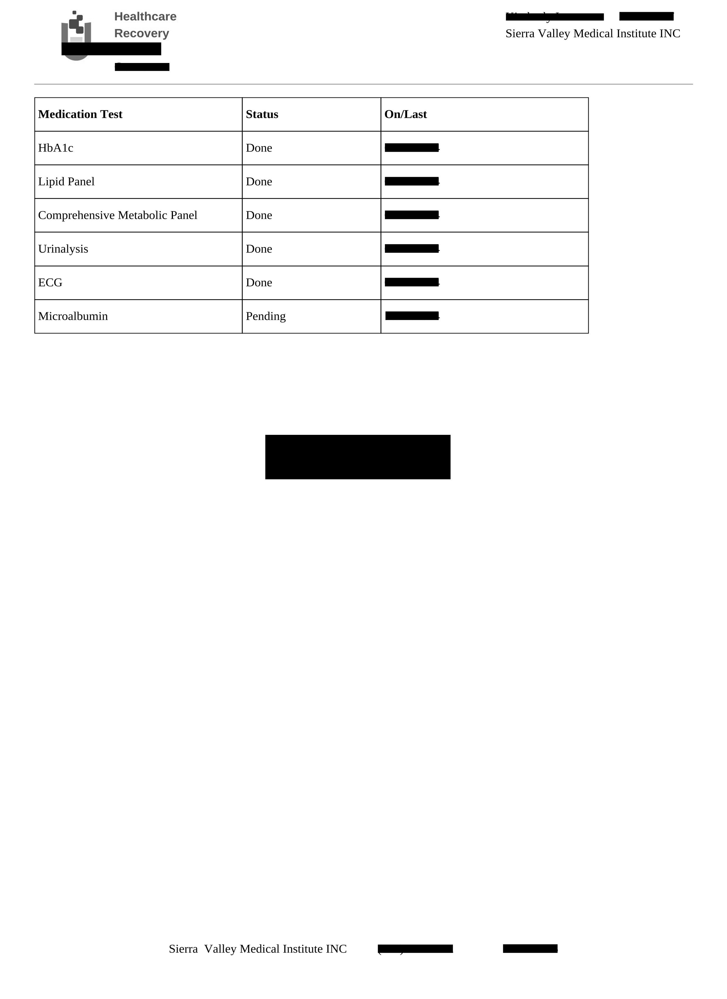


    Image #1:
    Origin: file:/content/source_pdfs/Other/PDF_Deid_Deidentification_0_Signature.pdf
    Resolution: 300 dpi
    Width: 2400 px
    Height: 3299 px
    Mode: 10
    Number of channels: 1


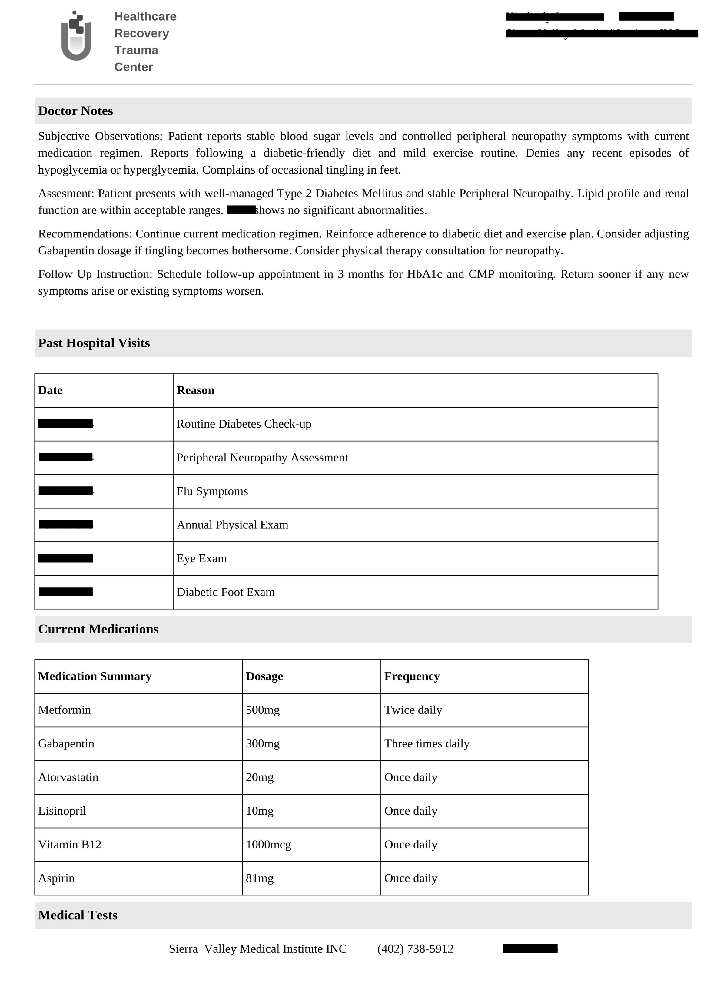


    Image #2:
    Origin: file:/content/source_pdfs/Other/PDF_Deid_Deidentification_0_Signature.pdf
    Resolution: 300 dpi
    Width: 2400 px
    Height: 3299 px
    Mode: 10
    Number of channels: 1


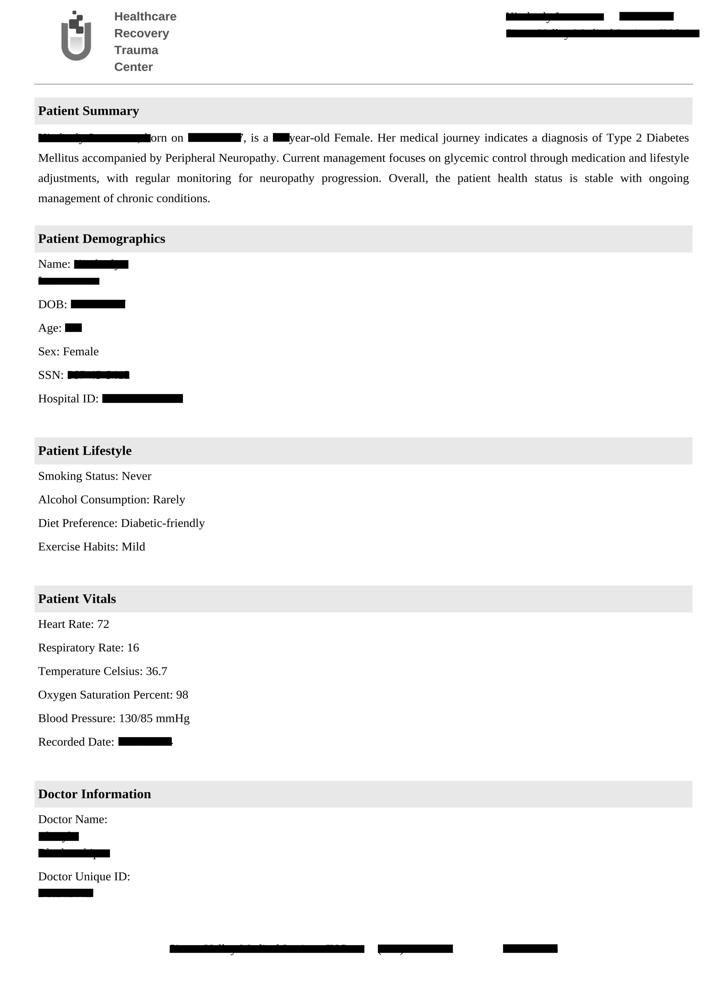

In [5]:
deid_signature_pipeline = PretrainedPipeline("pdf_deid_multilingual_name_plus_signature_aware", "en", "clinical/ocr")

result = deid_signature_pipeline.transform(signature_input_df).cache()

display_pdf(df=result, field="pdf")

### 📄 PDF De-Identification — Multi-Model Context Pipeline

🔗 [Pipeline Link](https://nlp.johnsnowlabs.com/2025/05/09/pdf_deid_multi_model_context_pipeline.html)

This pipeline can be used to **mask PHI (Protected Health Information) in PDFs**.  
The output is a **PDF document**, visually similar to the input, but with **black bounding boxes** over the targeted entities.

---

**🧾 Predicted Entities**
- 👶 AGE  
- 🏙️ CITY  
- 🌍 COUNTRY  
- 📅 DATE  
- 👨‍⚕️ DOCTOR  
- 📧 EMAIL  
- 🏥 HOSPITAL  
- 🔢 IDNUM  
- 🏢 ORGANIZATION  
- 🧑‍⚕️ PATIENT  
- ☎️ PHONE  
- 👔 PROFESSION  
- 🏞️ STATE  
- 🛣️ STREET  
- 🆔 USERNAME  
- 🔢 ZIP  

---

###  Variants Available
- **Obfuscation Variant** → [Link](https://nlp.johnsnowlabs.com/2025/05/09/pdf_obfuscation_multi_model_context_pipeline.html)  
  *(Replaces sensitive text with synthetic placeholders instead of simply masking.)*

- **Signature-Aware Variant** → [Link](https://nlp.johnsnowlabs.com/2025/05/23/pdf_deid_multi_model_context_signature_aware_pipeline.html)  
  *(Ensures document signatures remain intact while anonymizing PHI.)*


pdf_deid_multi_model_context_signature_aware_pipeline download started this may take some time.
Approx size to download 4.7 GB
[OK!]

    Image #0:
    Origin: file:/content/source_pdfs/Other/PDF_Deid_Deidentification_0_Signature.pdf
    Resolution: 300 dpi
    Width: 2400 px
    Height: 3299 px
    Mode: 10
    Number of channels: 1


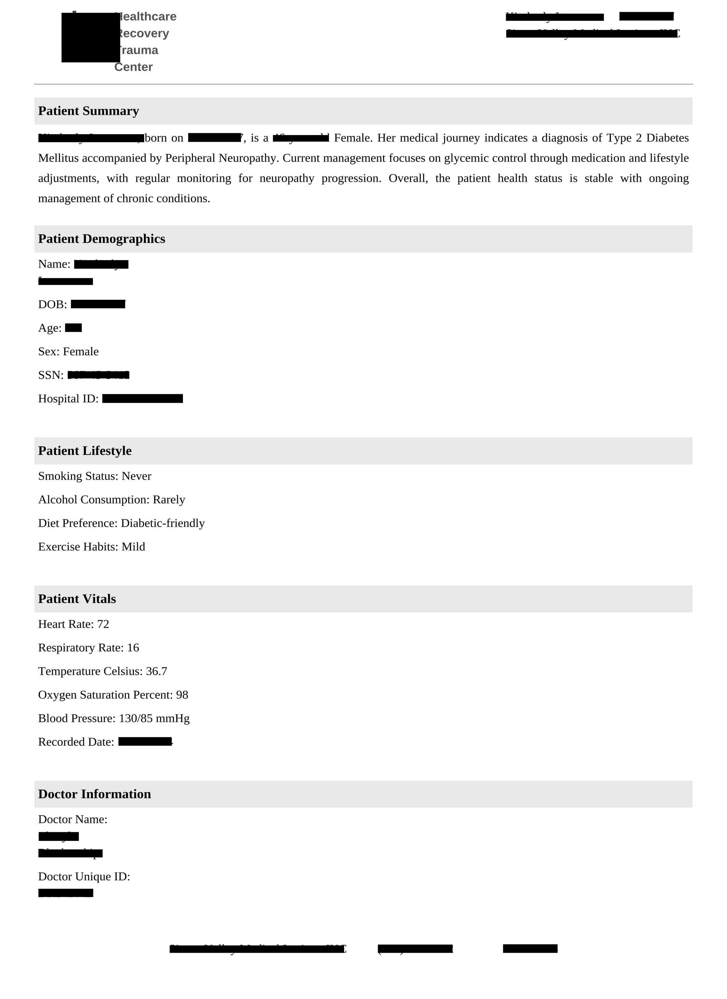


    Image #1:
    Origin: file:/content/source_pdfs/Other/PDF_Deid_Deidentification_0_Signature.pdf
    Resolution: 300 dpi
    Width: 2400 px
    Height: 3299 px
    Mode: 10
    Number of channels: 1


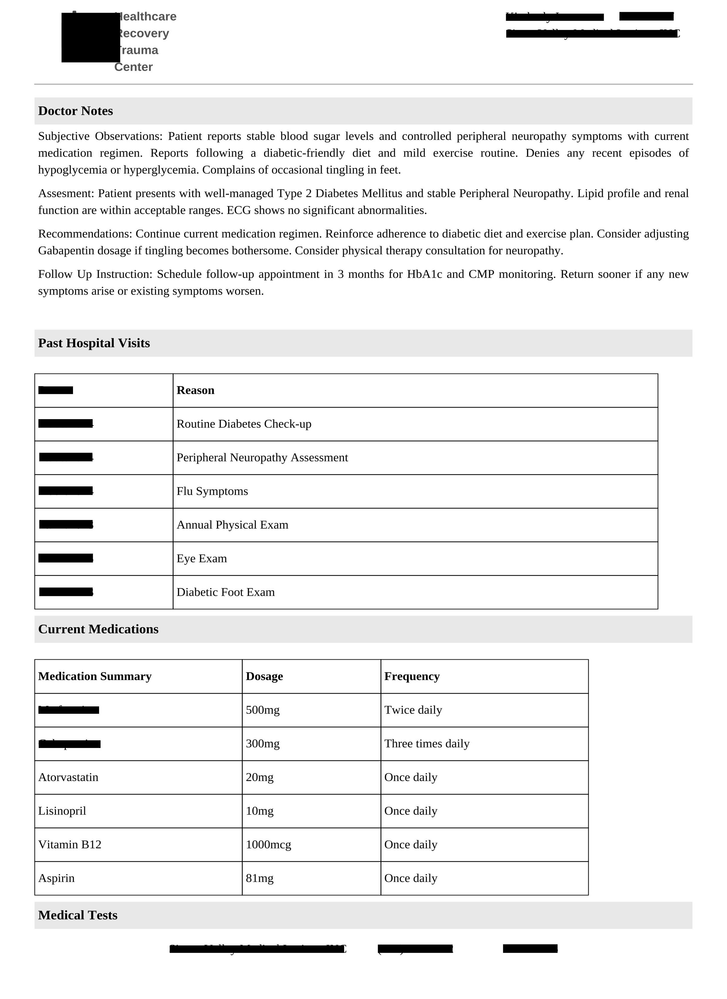


    Image #2:
    Origin: file:/content/source_pdfs/Other/PDF_Deid_Deidentification_0_Signature.pdf
    Resolution: 300 dpi
    Width: 2400 px
    Height: 3299 px
    Mode: 10
    Number of channels: 1


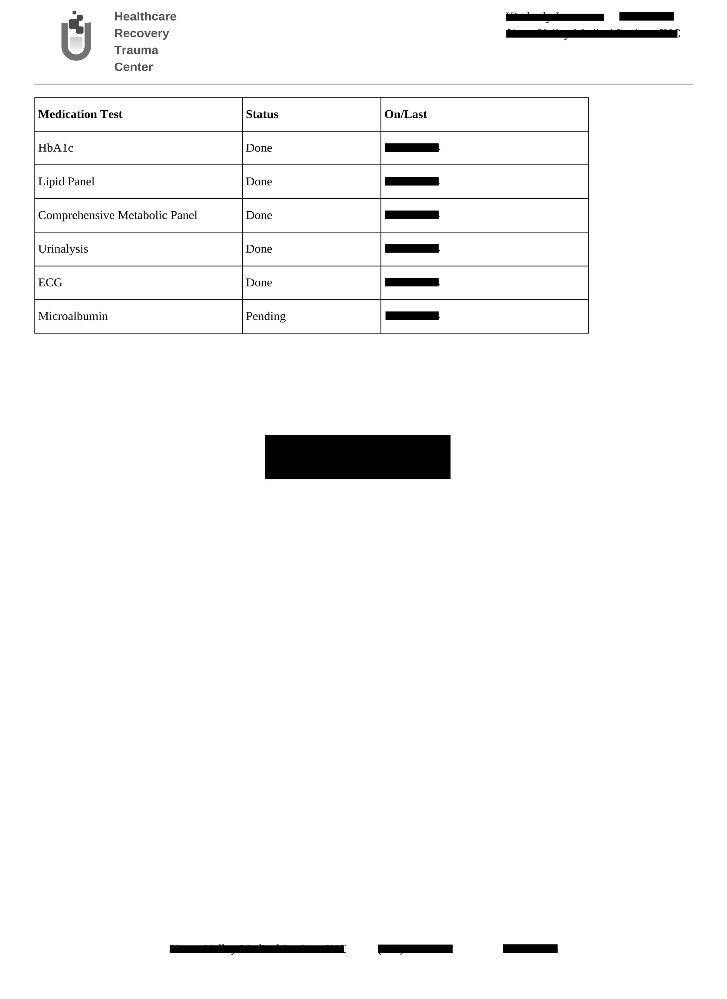

In [6]:
deid_signature_pipeline = PretrainedPipeline("pdf_deid_multi_model_context_signature_aware_pipeline", "en", "clinical/ocr")

result = deid_signature_pipeline.transform(signature_input_df).cache()

display_pdf(df=result, field="pdf")

### 📄 PDF De-identification — Subentity Context Augmented (EN)

🔗 [Pipeline Link](https://nlp.johnsnowlabs.com/2024/06/12/pdf_deid_subentity_context_augmented_pipeline_en.html)

This pipeline can be used to **mask PHI information in PDFs**.  
The output is a **PDF document**, visually similar to the input, but with **black bounding boxes** 🟥 placed over the targeted entities.

---

**🧾 Predicted Entities**
- 👶 AGE  
- 🧬 BIOID  
- 🏙️ CITY  
- 🌍 COUNTRY  
- 📅 DATE  
- 🖥️ DEVICE  
- 👨‍⚕️ DOCTOR  
- 📧 EMAIL  
- 📠 FAX  
- 🏥 HEALTHPLAN  
- 🏥 HOSPITAL  
- 🔢 IDNUM  
- 📍 LOCATION  
- 📑 MEDICALRECORD  
- 🏢 ORGANIZATION  
- 🧑‍⚕️ PATIENT  
- ☎️ PHONE  
- 👔 PROFESSION  
- 🏞️ STATE  
- 🛣️ STREET  
- 🔗 URL  
- 🆔 USERNAME  
- 🔢 ZIP  
- 💳 ACCOUNT  
- 🪪 LICENSE  
- 🚗 VIN  
- 🧾 SSN  
- 🪪 DLN  
- 🚘 PLATE  
- 💻 IPADDR  

pdf_deid_subentity_context_augmented_pipeline download started this may take some time.
Approx size to download 1.6 GB
[OK!]

    Image #0:
    Origin: file:/content/source_pdfs/Medium/PDF_Deid_Deidentification_Medium_0.pdf
    Resolution: 300 dpi
    Width: 2700 px
    Height: 3599 px
    Mode: 10
    Number of channels: 1


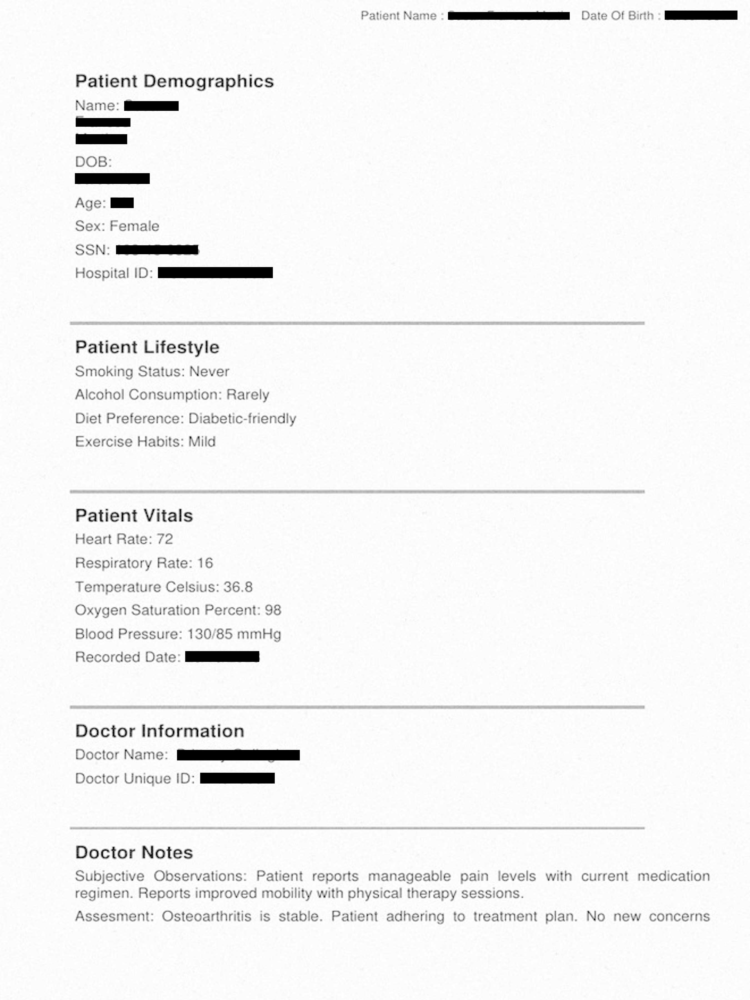


    Image #1:
    Origin: file:/content/source_pdfs/Medium/PDF_Deid_Deidentification_Medium_0.pdf
    Resolution: 300 dpi
    Width: 2700 px
    Height: 3599 px
    Mode: 10
    Number of channels: 1


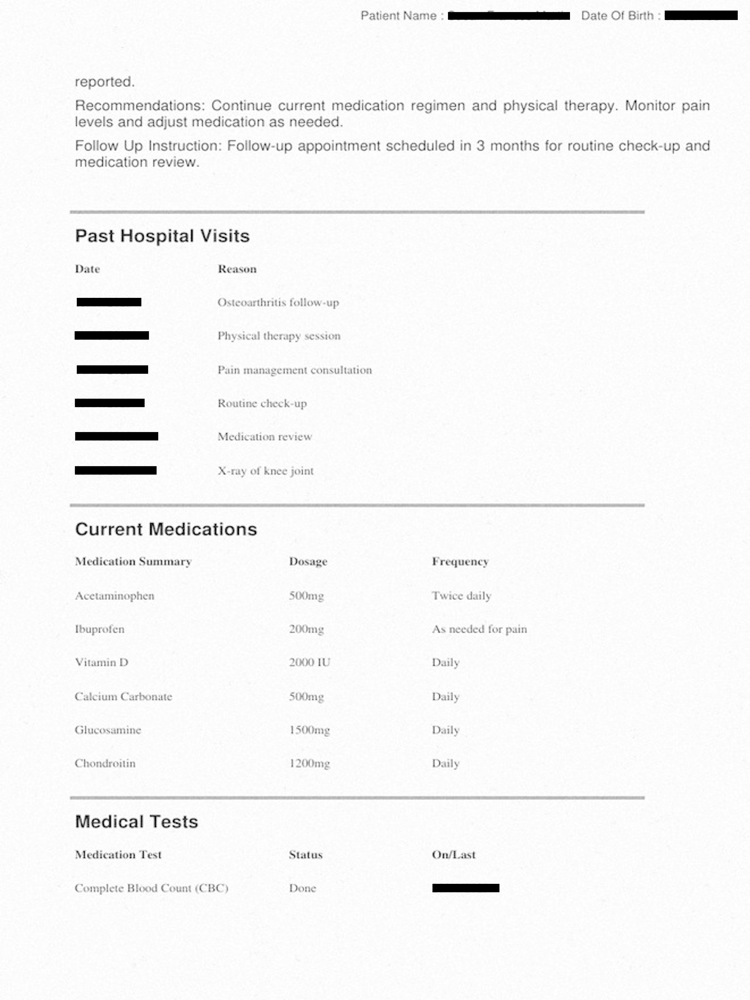


    Image #2:
    Origin: file:/content/source_pdfs/Medium/PDF_Deid_Deidentification_Medium_0.pdf
    Resolution: 300 dpi
    Width: 2700 px
    Height: 3599 px
    Mode: 10
    Number of channels: 1


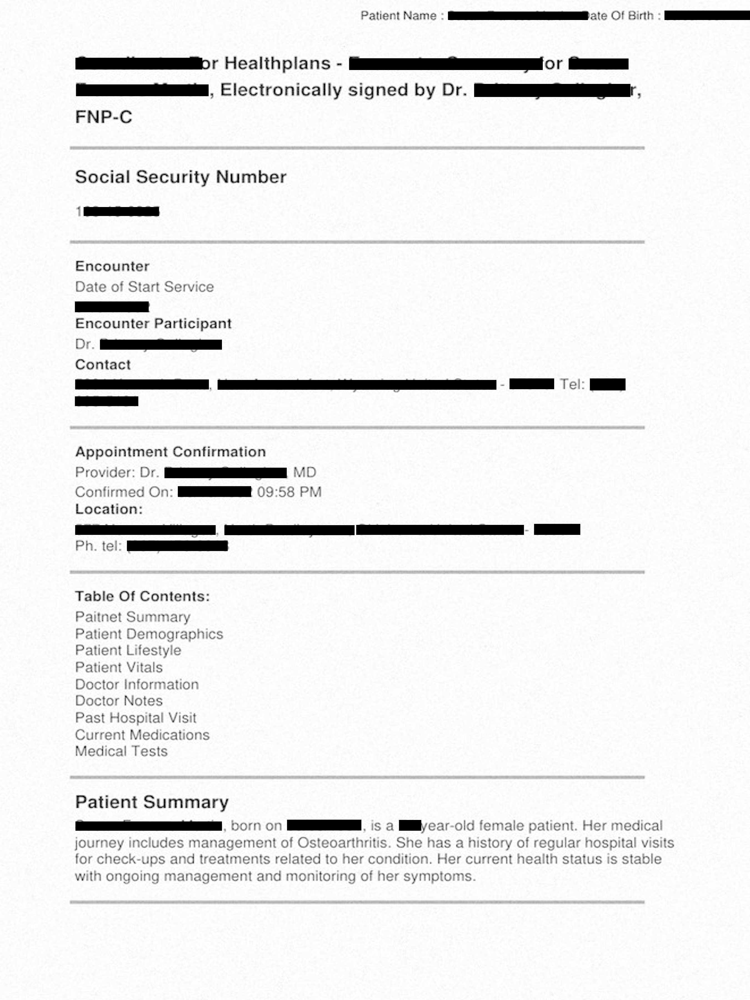


    Image #3:
    Origin: file:/content/source_pdfs/Medium/PDF_Deid_Deidentification_Medium_0.pdf
    Resolution: 300 dpi
    Width: 2700 px
    Height: 3599 px
    Mode: 10
    Number of channels: 1


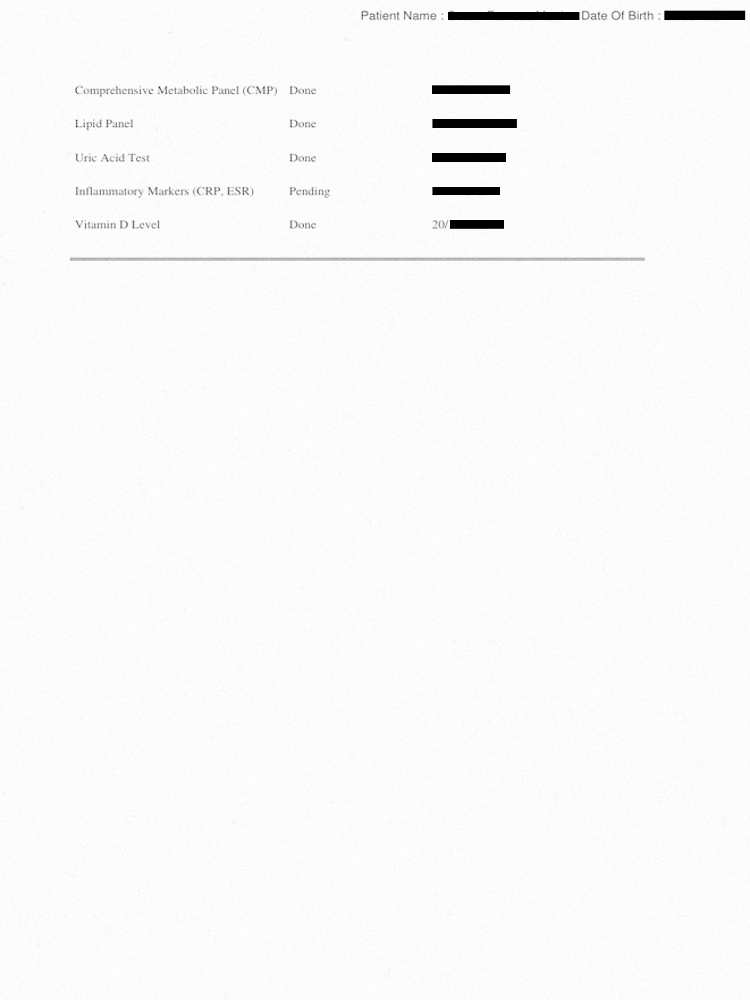

In [7]:
deid_pipeline = PretrainedPipeline("pdf_deid_subentity_context_augmented_pipeline", "en", "clinical/models")

result = deid_pipeline.transform(medium_input_df).cache()

display_pdf(df=result, field="pdf")

### 🖼️ Image Variants of Pipelines

Both **Multi-Model Context Pipeline** and **Multilingual Name Plus Pipeline**  
can be easily converted into **Image variations** using the `convert_to_image` variant.

- `pdf_deid_multi_model_context_pipeline` → `image_deid_multi_model_context_pipeline`  
- `pdf_deid_multilingual_name_plus` → `image_deid_multilingual_name_plus`  

---

📌 This means instead of de-identifying **PDFs**, these pipelines can directly process **images** (JPEG, PNG, TIFF, etc.),  
producing outputs with bounding boxes 🟥 or obfuscation over PHI in image files.

In [8]:
def convert_to_image(pipeline, image_type=ImageType.TYPE_3BYTE_BGR):
  """
  Convert PDF Pretrained Pipeline to Image Pretrained Pipeline
  """
  stages = pipeline.model.stages
  stage_names = ["".join(stage.uid.split("_")[:-1]) for stage in stages]

  if not isinstance(image_type, ImageType):
    raise ValueError("Invalid Image Type")

  if stage_names[0] == "PdfToImage" and stage_names[-1] in ["ImageToPdf", "PdfAssembler"]:

    print("Converting to Image Pretrained Pipeline")

    image_stages = stages[:-1]
    output_col = image_stages[0].getOrDefault(image_stages[0].getParam("outputCol"))
    image_stages[0] = BinaryToImage().setInputCol("content").setOutputCol(output_col).setImageType(image_type)
    return Pipeline(stages=image_stages)
  else:
    raise ValueError("Invalid Pretrained Pipeline")

In [9]:
# Use PdfToImage to extract Images from PDF and save to temp location.
pdf_to_image = PdfToImage() \
  .setInputCol("content") \
  .setSplitNumBatch(10) \
  .setResolution(400) \
  .setOutputCol("image_raw") \
  .setImageType(ImageType.TYPE_3BYTE_BGR) \
  .setSplittingStategy(SplittingStrategy.FIXED_NUMBER_OF_PARTITIONS)

# Call PDF To Image
images = pdf_to_image.transform(easy_input_df)

# Extract the first page and convert to image, can be repurposed to save image to disk.
image_dict = images.filter(F.col("pagenum") == 0).select("image_raw").collect()[0].asDict()["image_raw"]
mode = image_dict["mode"]
image = to_pil_image(image_dict, mode)

# Save to Temporary Location
import tempfile

with tempfile.NamedTemporaryFile(delete=False, suffix=".png") as tmp_file:
    image.save(tmp_file.name, format="PNG")
    print(f"Image saved at: {tmp_file.name}")

Image saved at: /tmp/tmps3c4c9pz.png


pdf_deid_multi_model_context_pipeline download started this may take some time.
Approx size to download 4.4 GB
[OK!]
Converting to Image Pretrained Pipeline


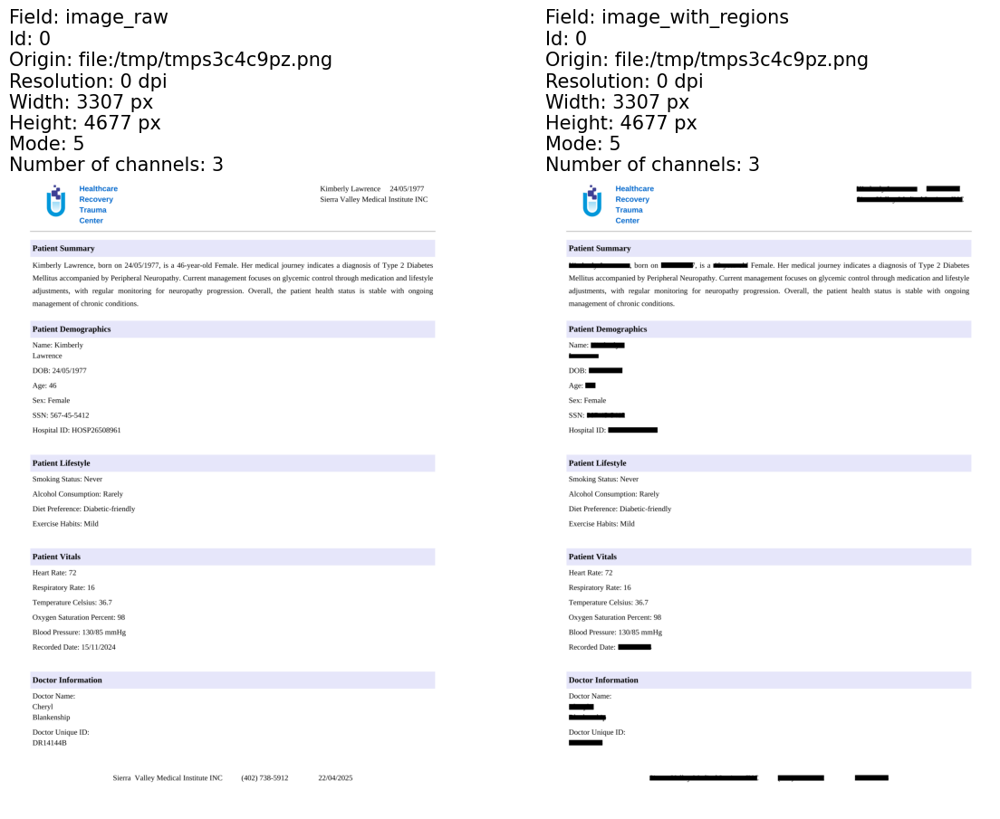

In [10]:
#Converting pdf_deid_multi_model_context_pipeline to Image variant.
deid_pipeline = PretrainedPipeline("pdf_deid_multi_model_context_pipeline", "en", "clinical/ocr")

image_pipe = convert_to_image(deid_pipeline)

df = spark.read.format("binaryFile").load(tmp_file.name)

result = image_pipe.fit(df).transform(df).cache()

display_images_horizontal(result.orderBy(F.col("pagenum")), "image_raw,image_with_regions")

In [11]:
#Converting pdf_obfuscation_multi_model_context_pipeline to Image variant.
#obfuscation_pipeline = PretrainedPipeline("pdf_obfuscation_multi_model_context_pipeline", "en", "clinical/ocr")

#image_pipe = convert_to_image(obfuscation_pipeline)

#df = spark.read.format("binaryFile").load(tmp_file.name)

#result = image_pipe.fit(df).transform(df).cache()

#display_images_horizontal(result.orderBy(F.col("pagenum")), "image_raw,image_with_regions")

In [12]:
#Converting pdf_deid_multilingual_name_plus to Image variant.
#deid_pipeline = PretrainedPipeline("pdf_deid_multilingual_name_plus", "en", "clinical/ocr")

#image_pipe = convert_to_image(deid_pipeline)

#df = spark.read.format("binaryFile").load(tmp_file.name)

#result = image_pipe.fit(df).transform(df).cache()

#display_images_horizontal(result.orderBy(F.col("pagenum")), "image_raw,image_with_regions")

In [13]:
#Converting pdf_deid_subentity_context_augmented_pipeline to Image variant.
#deid_pipeline = PretrainedPipeline("pdf_deid_subentity_context_augmented_pipeline", "en", "clinical/models")

#image_pipe = convert_to_image(deid_pipeline)

#df = spark.read.format("binaryFile").load(tmp_file.name)

#result = image_pipe.fit(df).transform(df).cache()

#display_images_horizontal(result.orderBy(F.col("pagenum")), "image_raw,cleaned_images")

In [14]:
tmp_file.close()